## Logistic Map

In [2]:
using Pkg
Pkg.add("Plots")

    Updating registry at `~/.julia/registries/General.toml`
   Resolving package versions...
   Installed JLFzf ─────────────── v0.1.11
   Installed NaNMath ───────────── v1.1.3
   Installed PtrArrays ─────────── v1.3.0
   Installed IrrationalConstants ─ v0.2.4
   Installed DataStructures ────── v0.18.22
   Installed Unitful ───────────── v1.22.0
   Installed StatsBase ─────────── v0.34.5
   Installed MacroTools ────────── v0.5.16
   Installed Requires ──────────── v1.3.1
   Installed ColorTypes ────────── v0.12.1
   Installed Latexify ──────────── v0.16.7
   Installed Plots ─────────────── v1.40.13
   Installed ColorSchemes ──────── v3.29.0
    Updating `~/Docencia/PDE/book/Project.toml`
  [91a5bcdd] + Plots v1.40.13
    Updating `~/Docencia/PDE/book/Manifest.toml`
  [66dad0bd] + AliasTables v1.1.3
  [35d6a980] + ColorSchemes v3.29.0
  [3da002f7] + ColorTypes v0.12.1
  [c3611d14] + ColorVectorSpace v0.11.0
  [5ae59095] + Colors v0.13.0
  [34da2185] + Compat v4.16.0
  [d38c429a] + Cont

In [5]:
using Plots

The logistc map is given by

$$
l(x) 
= r \cdot x\cdot (1-x)
$$

where:
- $ x_n \in [0,1] $: Normalized population at step  $n$,
- $r \in [0,4] $: Growth rate parameter.


In [6]:
#function l(x,r)
#    return r*x*(1-x)
#end

l(x,r) = r*x*(1-x)


l (generic function with 1 method)

### Fixed points
In a dynamical system, $f(x)$ has a stable fixed point if $|f'(x)| < 1$ in that fixed point. In this case, $l(x)$ has two fixed points,
$x = 0$ and $x = \frac{r-1}{r}$. 

Since $l'(x) = r\cdot(1-2x)$, we can verify the stability of the two fixed points:
* $x = 0$ is stable for $r < 1$, and unstable for $r \ge 1$.
* $x = \frac{r-1}{r}$, $l'(\frac{r-1}{r}) = 2-r$, so this fixed point is stable for $r \in (1,3)$.

We can analize the fixed points for several values of $r$ seeing the intersections between the curves $y=l(x)$ and $y=x$.

In [9]:
myarray = [1,2,3,4]

4-element Vector{Int64}:
 1
 2
 3
 4

In [10]:
f(x) = x*x

f (generic function with 1 method)

In [14]:
f.(myarray)

4-element Vector{Int64}:
  1
  4
  9
 16

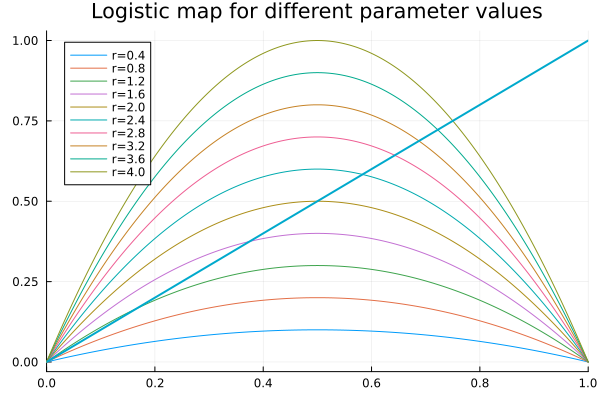

In [15]:
plt = plot(title="Logistic map for different parameter values", xlim = (0.0,1.0))
x = 0:0.001:1
for i in 1:10                           #We plot for ten values of r
    r = 4*i/10
    plot!(plt, x,l.(x,r), label="r=$r")
end
plot!(x,x, lw=2, label="")              #We plot y=x
plt

If you try to find the fixed points vía the map: $x \to l(x)$ or 
$$
x_{n+1} = l(x_n)
$$

you can see in the graph below whether the sequence converges or not and towards which point.

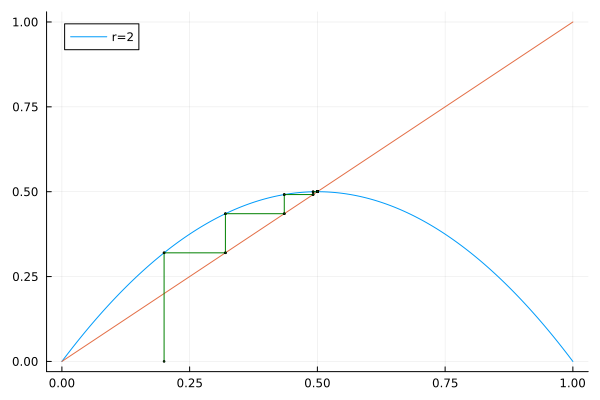

In [22]:
N=600                           #Number of iterations
X = zeros(N)                    #Where we store the values of each iteration

"""
This function recives r, an initial x0, the number of iterations N, and the array where to
save the values after each iteration.
"""
function iterates!(r,x0,N,X)
    X[1] = x0 #First value
    for i in 2:N
        X[i] = l(X[i-1],r) #We store the value of each iteration xₙ₊₁ = l(xₙ)
    end
    return X[:]
end


#r=3.6
#r = 3.45949
#r = 3
#r = 1
r = 2


iterates!(r,0.2,N,X)                                                    #We call iterates!
plt = plot(x,l.(x,r),label="r=$r")                                      #We plot y = l(x,r)
plot!(x,x, label="")                                                    #We plot y = x
#We plot the values of each iteration, and connect each iteration with a green line.
plot!([X[1];X[1]],[0.0;X[2]],label="", ms=1, color=:green)
scatter!([X[1];X[1]],[0.0;X[2]], label="", ms=1, color=:green)
for i in 2:(N-1)
    plot!([X[i-1];X[i]],[X[i];X[i]], label="", ms=1, color=:green)
    scatter!([X[i-1];X[i]],[X[i];X[i]], label="", ms=1, color=:green)
    plot!([X[i];X[i]],[X[i];X[i+1]], label="", ms=1, color=:green)
    scatter!([X[i];X[i]],[X[i];X[i+1]], label="", ms=1, color=:green)
end
plt


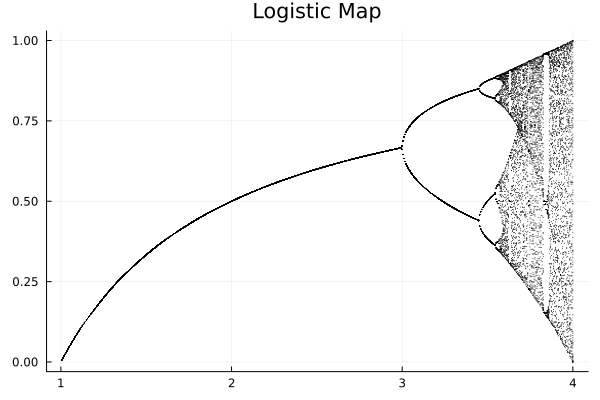

In [13]:
M = 500             #Number of values of r we will examine
N_transient = 500   #Number of iterations we will do to let the system stabilize
N_keep = 100        #Number of iterations we will keep after the transient
X_transient = zeros(N_transient)
X_keep = zeros(N_keep)

plt = plot(title="Logistic Map",legend=false)
for i in 1:M
    r = 3*i/M + 1
    iterates!(r,0.2,N_transient,X_transient)        #We do the transient iterations
    iterates!(r,X_transient[end], N_keep, X_keep)   #We do the remaining N_keep iterations, starting at the last value of X_transient
    scatter!(fill(r, N_keep),X_keep,ms=0.1,color=:green)
end

savefig("logistic_map.png") 

if N_keep <= 100
    display(plt)
end



### Key Properties

#### **(A) Fixed Points & Stability**
Fixed points $ x^* $ satisfy $ x_{n+1} = x_n $.  
- **Trivial fixed point**:  
  $ x^* = 0 $ (always exists).  
  - **Stability**:  
    - Stable for $ r < 1 $,
    - Unstable for $ r \geq 1 $.

- **Non-trivial fixed point**:  
  $ x^* = 1 - \frac{1}{r} $ exists for $ r \geq 1 $).  
  - **Stability**:  
    - Stable for $ 1 < r < 3 $ (attracts nearby orbits),
    - Loses stability at $ r = 3 $ via a **period-doubling bifurcation**.

#### **(B) Bifurcations**
As $ r $ increases, the system undergoes:
1. **First bifurcation (r = 3)**:  
   - Stable fixed point becomes unstable, giving rise to a **stable 2-cycle**.
2. **Feigenbaum cascade (3 < r < 3.5699...)**:  
   - Infinite sequence of period-doublings (2 → 4 → 8 → ...).
   - Governed by the **Feigenbaum constant** $ \delta \approx 4.669 $, universal for many chaotic systems.
3. **Onset of chaos (r ≈ 3.5699)**:  
   - Orbits become aperiodic (sensitive dependence on initial conditions).

#### **(C) Chaos & Ergodic Behavior**
- **Lyapunov exponent** $ \lambda $:  
  - $ \lambda > 0 $ indicates chaos (e.g., $ \lambda = \ln 2 $ at $ r = 4 $).
- **Topological mixing**:  
  Orbits fill the interval $[0,1]$ densely for $ r = 4 $.
- **Bernoulli shift**:  
  At $ r = 4 $, the map is conjugate to a maximally chaotic system.



As we saw, for $r ∈ (3, 3.5699...)$ the system has a bifurcation. We can study this bifurcation by studying the function $l(l(x))$.

This is because, in a bifurcation, we have two points $x_1$ and $x_2$, such that $x_2 = l(x_1)$ and $x_1 = l(x_2)$.

 Therefore, $x_1 = l(l(x_1))$, which is to say that $x_1$ and $x_2$ are fixed points of $l(l(x))$. Similarly we can find larger cycles by continuously composing $l(x)$ with itself.

In [24]:
#This function composes l(x) n times.
function l_n(x, r, n)
    for i in 1:n
        x = l(x,r)
    end
    return x
end


l_n (generic function with 1 method)

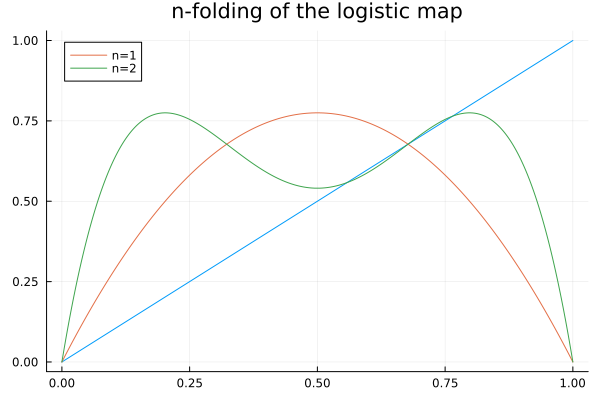

In [25]:
#Here, we plot x, l(x) and l(l(x)). You can plot more compositions of l by changing the for loop.
plt = plot(x,x,title="n-folding of the logistic map", label="",legend=:topleft)
for i in 1:2
    plot!(x,l_n.(x,3.1,i), label="n=$i")
end

plt

**Customization:** Adjust r_range to zoom in on specific bifurcations (e.g., 3.8:0.0001:4.0 for chaos).

## Key Properties

### **(A) Fixed Points & Stability**
Fixed points $ x^* $ satisfy $ x_{n+1} = x_n $.  
- **Trivial fixed point**:  
  $ x^* = 0 $ (always exists).  
  - **Stability**:  
    - Stable for $ r < 1 $,
    - Unstable for $ r \geq 1 $.

- **Non-trivial fixed point**:  
  $ x^* = 1 - \frac{1}{r} $ exists for $ r \geq 1 $).  
  - **Stability**:  
    - Stable for $ 1 < r < 3 $ (attracts nearby orbits),
    - Loses stability at $ r = 3 $ via a **period-doubling bifurcation**.

### **(B) Bifurcations**
As $ r $ increases, the system undergoes:
1. **First bifurcation (r = 3)**:  
   - Stable fixed point becomes unstable, giving rise to a **stable 2-cycle**.
2. **Feigenbaum cascade (3 < r < 3.5699...)**:  
   - Infinite sequence of period-doublings (2 → 4 → 8 → ...).
   - Governed by the **Feigenbaum constant** $ \delta \approx 4.669 $, universal for many chaotic systems.
3. **Onset of chaos (r ≈ 3.5699)**:  
   - Orbits become aperiodic (sensitive dependence on initial conditions).

### **(C) Chaos & Ergodic Behavior**
- **Lyapunov exponent** $ \lambda $:  
  - $ \lambda > 0 $ indicates chaos (e.g., $ \lambda = \ln 2 $ at $ r = 4 $).
- **Topological mixing**:  
  Orbits fill the interval $[0,1]$ densely for $ r = 4 $.
- **Bernoulli shift**:  
  At $ r = 4 $, the map is conjugate to a maximally chaotic system.

### **(D) Universality**
- The **Feigenbaum constants** ($ \delta \approx 4.669 $, $ \alpha \approx 2.502 $) appear in all unimodal maps with quadratic maxima (e.g., sine map).


In [ ]:
# Lyapunov exponent
function lyapunov_exponent(x₀, r, n_steps)
    x = x₀
    λ = 0.0
    for _ in 1:n_steps
        x = r * x * (1 - x)
        λ += log(abs(r * (1 - 2x)))
    end
    return λ / n_steps
end

# Generate plots
let
    r_range = 2.5:0.001:4.0
    bifurcation_diagram(r_range, 1000, 100)
    
    # Lyapunov plot
    r_lyap = 2.8:0.01:4.0
    λ = [lyapunov_exponent(0.5, r, 1000) for r in r_lyap]
    plot(r_lyap, λ, xlabel="r", ylabel="λ", title="Lyapunov Exponent", label="λ(r)")
    hline!([0], linestyle=:dash, color=:red, label="Stability threshold")
end



## **Applications**
- **Population biology**: Models species growth with limited resources.
- **Cryptography**: Chaos-based random number generators.
- **Physics**: Analogue for turbulence and phase transitions.

---

## **References**
- Strogatz, S. H. (1994). *Nonlinear Dynamics and Chaos*.  
- Feigenbaum, M. (1978). *Quantitative universality for a class of nonlinear transformations*.  

